In [ ]:
!pip install ETNA

# **1 Описание данных**

Датасет содержит данные о погоде с 1 января 2013 года по 24 апреля 2017 года в городе Дели, Индия. Признаки:  
средняя температура, влажность, скорость ветра

In [ ]:
import pandas as pd
from etna.datasets.tsdataset import TSDataset
from etna.metrics import SMAPE
from etna.analysis import plot_forecast

from etna.models import MovingAverageModel, NaiveModel
import matplotlib.pyplot as plt

In [ ]:
!wget 'https://drive.usercontent.google.com/uc?id=1BMYoVafISsWsLUAw86QnwItOfqgKDuoG&export=download' -O DelhiClimate.csv

In [ ]:
df = pd.read_csv('DelhiClimate.csv', index_col=[0])

In [ ]:
df.drop(index = 1461, inplace = True)
df1 = df.drop(columns = ['humidity', 'wind_speed', 'meanpressure'])
df2 = df.drop(columns = ['meantemp', 'wind_speed', 'meanpressure'])
df3 = df.drop(columns = ['humidity', 'meantemp', 'meanpressure'])
df1['segment'] = 'meantemp'
df2['segment'] = 'humidity'
df3['segment'] = 'windspeed'
df1.rename(columns={"meantemp": "target"}, inplace = True)
df2.rename(columns={"humidity": "target"}, inplace = True)
df3.rename(columns={"wind_speed": "target"}, inplace = True)
df5 = pd.concat([df1, df2, df3])
df5.rename(columns={"date": "timestamp"}, inplace = True)
df5['timestamp'] = pd.to_datetime(df5['timestamp'])

In [ ]:
df5.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4725 entries, 0 to 1460
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   timestamp  4725 non-null   datetime64[ns]
 1   target     4725 non-null   float64       
 2   segment    4725 non-null   object        
dtypes: datetime64[ns](1), float64(1), object(1)
memory usage: 147.7+ KB


In [ ]:
df6 = TSDataset.to_dataset(df5)

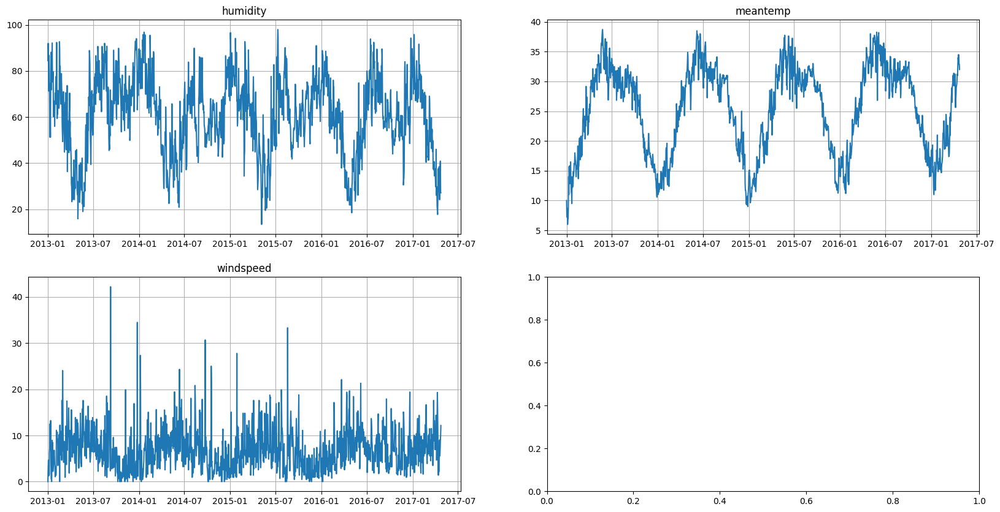

In [ ]:
ts = TSDataset(df6, 'D')
ts.plot()

# **2 Построение базовых моделей (baseline)**

## Наивная модель

In [ ]:
model_naive = NaiveModel(lag = 365)
train_ts, test_ts = ts.train_test_split(
    train_start = '2013-01-01',
    train_end = '2017-01-01',
    test_start = '2017-01-02',
    test_end = '2017-04-24'
)
model_naive.fit(train_ts)

NaiveModel(lag = 365, )

In [ ]:
HORIZON = 113
future_ts = train_ts.make_future(HORIZON, tail_steps = model_naive.context_size)
forecast_ts = model_naive.forecast(future_ts, prediction_size = HORIZON)

In [ ]:
smape = SMAPE()
naivesmape = smape(y_true = test_ts, y_pred = forecast_ts)
naivesmape

{'humidity': 17.751684261546625,
 'meantemp': 13.102552616260605,
 'windspeed': 67.96885050504105}

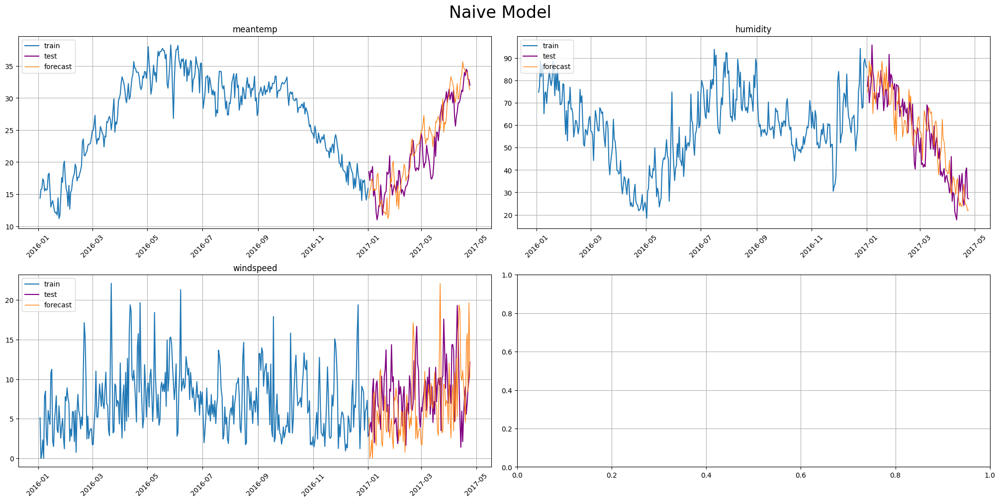

In [ ]:
plot_forecast(forecast_ts, test_ts, train_ts, n_train_samples = 365)
plt.suptitle('Naive Model', size=24)
plt.savefig('naive_model.jpeg')

## Модель скользящего среднего

In [ ]:
model_moving = MovingAverageModel(window = 150)

In [ ]:
model_moving.fit(train_ts)

MovingAverageModel(window = 150, )

In [ ]:
future_ts = train_ts.make_future(HORIZON, tail_steps = model_moving.context_size)
forecast_ts = model_moving.forecast(future_ts, prediction_size = HORIZON)

In [ ]:
movingsmape = smape(y_true = test_ts, y_pred = forecast_ts)
movingsmape

{'humidity': 31.299148772135304,
 'meantemp': 31.322904058115064,
 'windspeed': 40.48179848031898}

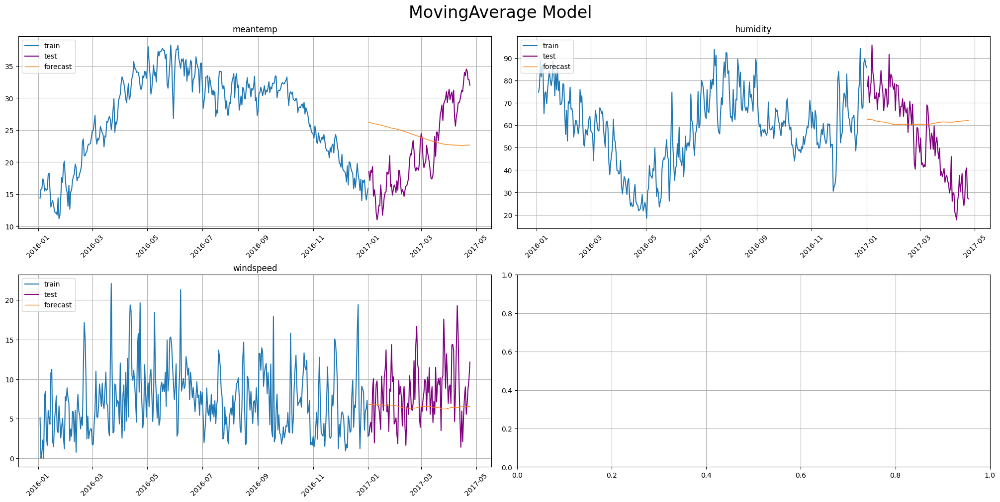

In [ ]:
plot_forecast(forecast_ts, test_ts, train_ts, n_train_samples = 365)
plt.suptitle('MovingAverage Model', size=24)
plt.savefig('mv_avrg_model.png')

## Модель сезонного скользящего среднего

In [ ]:
from etna.models import SeasonalMovingAverageModel

In [ ]:
mult_HORIZON = 113

In [ ]:
train_mult_ts, test_mult_ts = ts.train_test_split(
    train_start = '2013-01-01',
    train_end = '2017-01-01',
    test_start = '2017-01-02',
    test_end = '2017-04-24'
)

In [ ]:
import numpy as np

window = [7]
seasonality = range(30, 113, 7)
best_smape = float('inf')
best_window = None
best_seasonality = None
model_seasMovingAvrg = None

for w in window:
  print(f'w = {w}:')
  for s in seasonality:
    model_seasMovingAvrg = SeasonalMovingAverageModel(window=w, seasonality=s)
    model_seasMovingAvrg.fit(train_mult_ts)
    future_mult_ts = train_mult_ts.make_future(mult_HORIZON, tail_steps=model_seasMovingAvrg.context_size)
    forecast_mult_ts = model_seasMovingAvrg.forecast(future_mult_ts, prediction_size=mult_HORIZON)
    metrics = SMAPE()(y_true=test_mult_ts, y_pred=forecast_mult_ts)
    mean_smape = np.mean(list(metrics.values()))
    print(f'S={s} --- SMAPE: {mean_smape} --- {metrics}')

    if mean_smape < best_smape:
      best_smape = mean_smape
      best_window = w
      best_seasonality = s
      model_seasMovingAvrg = model_seasMovingAvrg
      best_metrics_seasMovingAvrg = metrics

print(f'\nЛучшее значение SMAPE: {best_smape} при размере окна: {best_window} и сезонности: {best_seasonality}')
print(f'Лучшие метрики: {best_metrics_seasMovingAvrg}')

w = 7:
S=30 --- SMAPE: 34.89930671338033 --- {'humidity': 31.04848739853058, 'meantemp': 33.86225123546983, 'windspeed': 39.78718150614057}
S=37 --- SMAPE: 37.679886562003006 --- {'humidity': 34.328028157341976, 'meantemp': 36.0974865777842, 'windspeed': 42.614144950882846}
S=44 --- SMAPE: 36.27970163462874 --- {'humidity': 33.02290408674101, 'meantemp': 36.05206659572703, 'windspeed': 39.76413422141821}
S=51 --- SMAPE: 34.27647144717392 --- {'humidity': 29.974376067206315, 'meantemp': 32.801664140401435, 'windspeed': 40.053374133914}
S=58 --- SMAPE: 33.40444752799211 --- {'humidity': 30.895596071784944, 'meantemp': 29.673527662296696, 'windspeed': 39.6442188498947}
S=65 --- SMAPE: 35.05415631364631 --- {'humidity': 31.183157114356714, 'meantemp': 29.68607401407776, 'windspeed': 44.293237812504444}
S=72 --- SMAPE: 35.10540362105937 --- {'humidity': 31.870861282473346, 'meantemp': 31.141200602607565, 'windspeed': 42.30414897809718}
S=79 --- SMAPE: 34.90362445312047 --- {'humidity': 30.3

In [ ]:
model_seasMovingAvrg = SeasonalMovingAverageModel(window=6, seasonality=1)
model_seasMovingAvrg.fit(train_mult_ts)

future_mult_ts = train_mult_ts.make_future(mult_HORIZON, tail_steps=model_seasMovingAvrg.context_size)

In [ ]:
forecast_mult_ts_3 = model_seasMovingAvrg.forecast(future_mult_ts, prediction_size=mult_HORIZON)

In [ ]:
SMAPE()(y_true=test_mult_ts, y_pred=forecast_mult_ts_3)

{'humidity': 45.580995003278915,
 'meantemp': 32.7550161893553,
 'windspeed': 48.69998834688254}

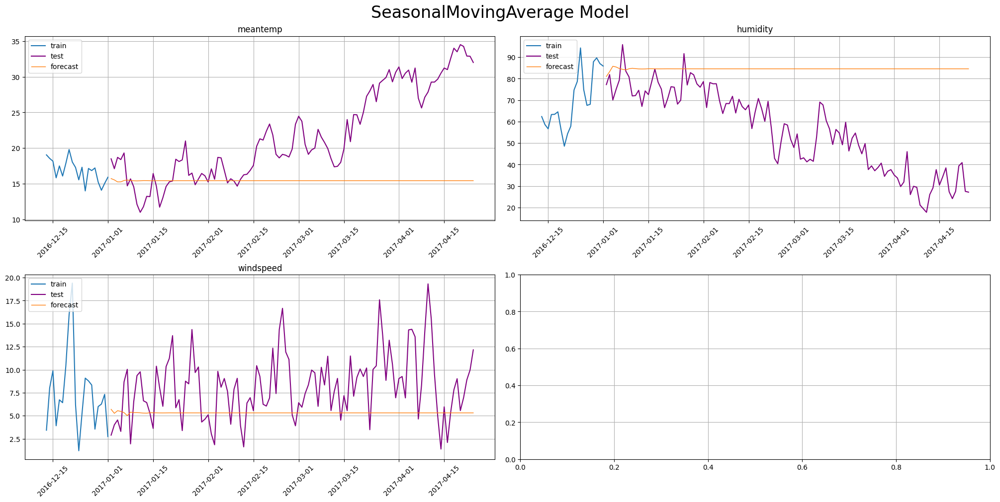

In [ ]:
plot_forecast(forecast_mult_ts_3, test_mult_ts, train_mult_ts, n_train_samples=20)
plt.suptitle('SeasonalMovingAverage Model', size=24)
plt.savefig('season_mv_avrg_model.png')

# **3 Построение модели CatBoost**

In [ ]:
from etna.models import CatBoostPerSegmentModel, CatBoostMultiSegmentModel

In [ ]:
HORIZON = 365
train_ts, test_ts = ts.train_test_split(test_size=HORIZON)
train_ts, valid_ts = train_ts.train_test_split(test_size=HORIZON)

In [ ]:
from etna.transforms import MeanTransform, LagTransform

mean8 = MeanTransform(
    in_column='target',
    window=365,
    out_column='mean_08'
)

lags = LagTransform(
    in_column='target',
    lags = list(range(128,365,1)),
    out_column='lag'
)

In [ ]:
train_ts.fit_transform([lags,mean8])

In [ ]:
train_ts.describe()

,start_timestamp,end_timestamp,length,num_missing,num_segments,num_exogs,num_regressors,num_known_future,freq
segments,,,,,,,,,
humidity,2013-01-01,2015-04-25,845,0,3,238,237,0,D
meantemp,2013-01-01,2015-04-25,845,0,3,238,237,0,D
windspeed,2013-01-01,2015-04-25,845,0,3,238,237,0,D


In [ ]:
from etna.analysis import plot_feature_relevance, ModelRelevanceTable
from sklearn.ensemble import RandomForestRegressor

/usr/local/lib/python3.10/dist-packages/etna/analysis/feature_relevance/relevance_table.py:33: UserWarning: Exogenous or target data contains None! It will be dropped for calculating relevance.
  warnings.warn("Exogenous or target data contains None! It will be dropped for calculating relevance.")
/usr/local/lib/python3.10/dist-packages/etna/analysis/feature_relevance/relevance_table.py:33: UserWarning: Exogenous or target data contains None! It will be dropped for calculating relevance.
  warnings.warn("Exogenous or target data contains None! It will be dropped for calculating relevance.")
/usr/local/lib/python3.10/dist-packages/etna/analysis/feature_relevance/relevance_table.py:33: UserWarning: Exogenous or target data contains None! It will be dropped for calculating relevance.
  warnings.warn("Exogenous or target data contains None! It will be dropped for calculating relevance.")


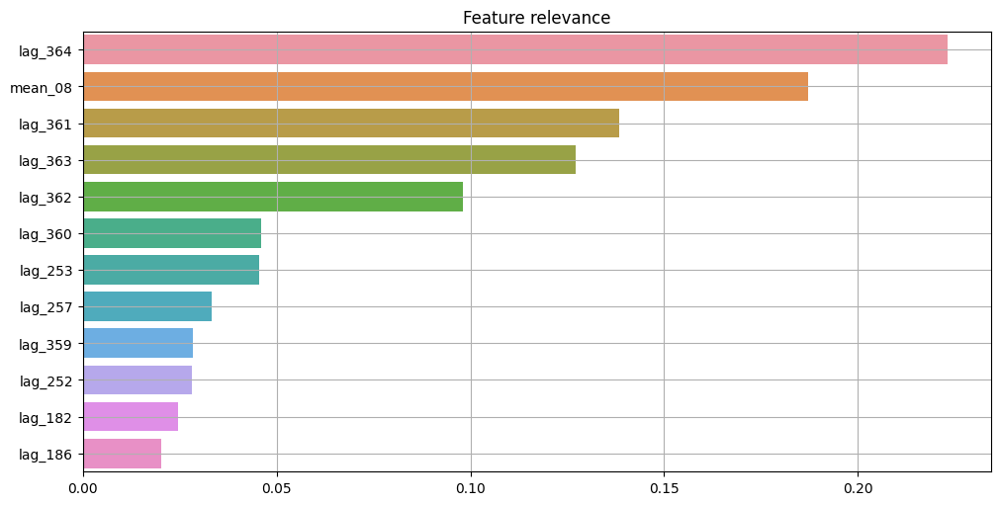

In [ ]:
plot_feature_relevance(
    ts=train_ts,
    relevance_table = ModelRelevanceTable(),
    normalized = True,
    top_k=12,
    relevance_params=dict(model=RandomForestRegressor(n_estimators=100))
)

In [ ]:
from etna.models import CatBoostPerSegmentModel, CatBoostMultiSegmentModel

In [ ]:
model_catboost = CatBoostMultiSegmentModel(loss_function='MAE',
                                  n_estimators=600,
                                  learning_rate=0.05,
                                  depth=9,
                                  random_seed=42
                                  )

In [ ]:
model_catboost.fit(train_ts)

CatBoostMultiSegmentModel(iterations = None, depth = 9, learning_rate = 0.05, logging_level = 'Silent', l2_leaf_reg = None, thread_count = None, loss_function = 'MAE', n_estimators = 600, random_seed = 42, )

In [ ]:
future_ts = train_ts.make_future(
    HORIZON,
    transforms=[lags,mean8]
)
future_ts

segment    humidity                                                          \
feature     lag_128 lag_129 lag_130 lag_131 lag_132 lag_133 lag_134 lag_135   
timestamp                                                                     
2015-04-26   81.750  79.750  72.125  72.375  75.750  86.625  71.875  65.625   
2015-04-27   77.000  81.750  79.750  72.125  72.375  75.750  86.625  71.875   
2015-04-28   79.125  77.000  81.750  79.750  72.125  72.375  75.750  86.625   
2015-04-29   85.000  79.125  77.000  81.750  79.750  72.125  72.375  75.750   
2015-04-30   78.625  85.000  79.125  77.000  81.750  79.750  72.125  72.375   
...             ...     ...     ...     ...     ...     ...     ...     ...   
2016-04-20      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
2016-04-21      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
2016-04-22      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
2016-04-23      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   
2016-04-24      NaN     NaN     NaN     NaN     NaN     NaN     NaN     NaN   

segment                     ...  windspeed                              \
feature    lag_136 lag_137  ...    lag_357   lag_358   lag_359 lag_360   
timestamp                   ...                                          
2015-04-26  70.500  65.500  ...   5.800000  6.475000  6.487500  9.7375   
2015-04-27  65.625  70.500  ...   9.037500  5.800000  6.475000  6.4875   
2015-04-28  71.875  65.625  ...   6.885714  9.037500  5.800000  6.4750   
2015-04-29  86.625  71.875  ...   1.850000  6.885714  9.037500  5.8000   
2015-04-30  75.750  86.625  ...  10.662500  1.850000  6.885714  9.0375   
...            ...     ...  ...        ...       ...       ...     ...   
2016-04-20     NaN     NaN  ...        NaN       NaN       NaN     NaN   
2016-04-21     NaN     NaN  ...        NaN       NaN       NaN     NaN   
2016-04-22     NaN     NaN  ...        NaN       NaN       NaN     NaN   
2016-04-23     NaN     NaN  ...        NaN       NaN       NaN     NaN   
2016-04-24     NaN     NaN  ...        NaN       NaN       NaN     NaN   

segment                                                           
feature     lag_361  lag_362  lag_363  lag_364    mean_08 target  
timestamp                                                         
2015-04-26   5.3375   8.3250  10.1875   8.3500   6.660385    NaN  
2015-04-27   9.7375   5.3375   8.3250  10.1875   6.655731    NaN  
2015-04-28   6.4875   9.7375   5.3375   8.3250   6.645975    NaN  
2015-04-29   6.4750   6.4875   9.7375   5.3375   6.641324    NaN  
2015-04-30   5.8000   6.4750   6.4875   9.7375   6.644945    NaN  
...             ...      ...      ...      ...        ...    ...  
2016-04-20  12.9750   2.5500   8.1000  11.3500   8.743750    NaN  
2016-04-21      NaN  12.9750   2.5500   8.1000   7.875000    NaN  
2016-04-22      NaN      NaN  12.9750   2.5500   7.762500    NaN  
2016-04-23      NaN      NaN      NaN  12.9750  12.975000    NaN  
2016-04-24      NaN      NaN      NaN      NaN   0.000000    NaN  

[365 rows x 717 columns]

In [ ]:
forecast_ts=model_catboost.forecast(future_ts)

In [ ]:
smape = SMAPE()
catboostsmape = smape(y_true=valid_ts, y_pred=forecast_ts)
catboostsmape

{'humidity': 49.66957550207552,
 'meantemp': 25.110527629444768,
 'windspeed': 66.62692983774924}

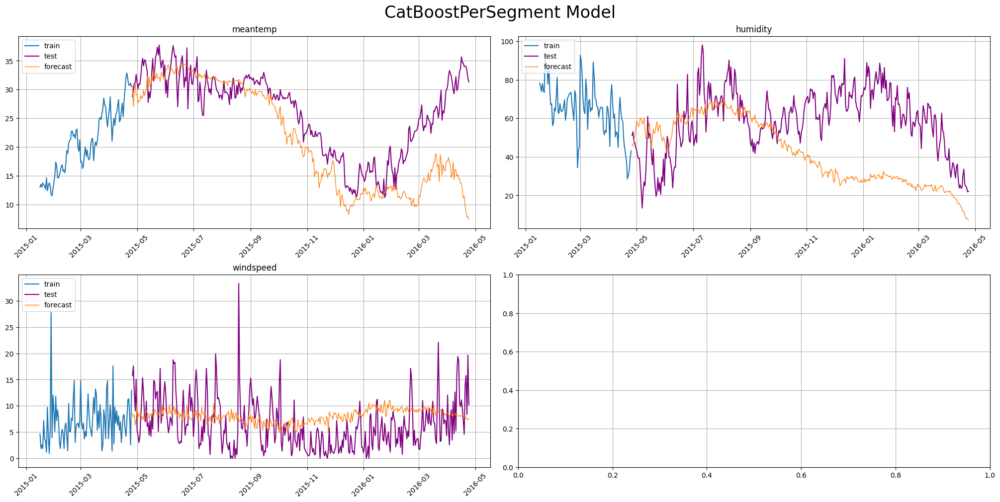

In [ ]:
plot_forecast(forecast_ts, valid_ts, train_ts, n_train_samples=100)
plt.suptitle('CatBoostPerSegment Model', size=24)
plt.savefig('cat_boost_model.png')

# **4 Подбор признакового пространства для модели CatBoost**

In [ ]:
from etna.pipeline import Pipeline
from etna.analysis import plot_forecast, plot_backtest

In [ ]:
HORIZON = 365

In [ ]:
mean8 = MeanTransform(
    in_column='target',
    window=365,
    out_column='mean_08'
)

In [ ]:
lags = LagTransform(
    in_column='target',
    lags = list(range(128,365,1)),
    out_column='lag'
)

In [ ]:
lags2 = LagTransform(
    in_column='target',
    lags = list(range(1,128,1)),
    out_column='lag'
)

In [ ]:
model = CatBoostMultiSegmentModel(loss_function='MAE',
                                  n_estimators=200,
                                  learning_rate=0.05,
                                  depth=6,
                                  random_seed=42
                                  )

In [ ]:
transforms=[lags,mean8]
pipeline = Pipeline(model=model,
                    transforms=transforms,
                    horizon=HORIZON)

In [ ]:
train_ts, test_ts = ts.train_test_split(test_size=HORIZON)

In [ ]:
smape = SMAPE()

In [ ]:
metrics_df, forecast_df, fold_info_df = pipeline.backtest(
    mode='expand',
    ts=train_ts,
    metrics=[smape],
    n_folds=2
)

[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:   14.7s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   29.0s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   29.0s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.6s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    1.3s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    1.3s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.1s


In [ ]:
fold_info_df

,train_start_time,train_end_time,test_start_time,test_end_time,fold_number
0,2013-01-01,2014-04-25,2014-04-26,2015-04-25,0
1,2013-01-01,2015-04-25,2015-04-26,2016-04-24,1


In [ ]:
metrics_df

,segment,SMAPE,fold_number
0,humidity,60.468115,0
0,humidity,46.658532,1
1,meantemp,42.264628,0
1,meantemp,23.054472,1
2,windspeed,59.457029,0
2,windspeed,65.052868,1


In [ ]:
print(metrics_df['SMAPE'].mean())
print(metrics_df['SMAPE'].std())

49.4926072531361
15.627692336365177


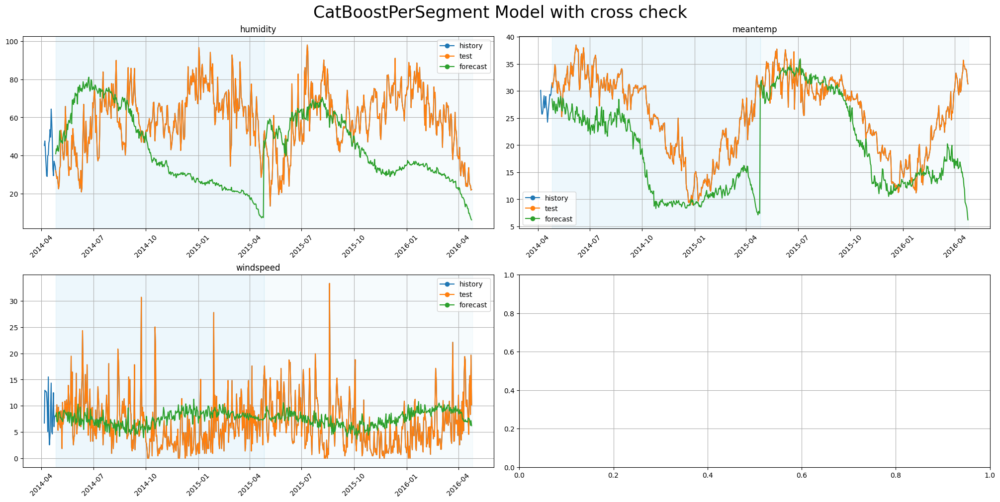

In [ ]:
plot_backtest(forecast_df, ts=train_ts,history_len=20)
plt.suptitle('CatBoostPerSegment Model with cross check', size=24)
plt.savefig('cat_boost_model_with_check.png')

In [ ]:
transforms2 = [lags2, mean8]

pipeline2 = Pipeline(model=model,
                    transforms=transforms2,
                    horizon=HORIZON)

In [ ]:
metrics_df, forecast_df, fold_info_df = pipeline2.backtest(
    mode='expand',
    ts=train_ts,
    metrics=[smape],
    n_folds=2
)

[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    8.7s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   15.6s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   15.6s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.4s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.8s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.8s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.1s


In [ ]:
fold_info_df

,train_start_time,train_end_time,test_start_time,test_end_time,fold_number
0,2013-01-01,2014-04-25,2014-04-26,2015-04-25,0
1,2013-01-01,2015-04-25,2015-04-26,2016-04-24,1


In [ ]:
metrics_df

,segment,SMAPE,fold_number
0,humidity,156.285494,0
0,humidity,150.659490,1
1,meantemp,142.984744,0
1,meantemp,131.813536,1
2,windspeed,83.999051,0
2,windspeed,77.547857,1


In [ ]:
print(metrics_df['SMAPE'].mean())
print(metrics_df['SMAPE'].std())

123.88169514442399
34.44516475556942


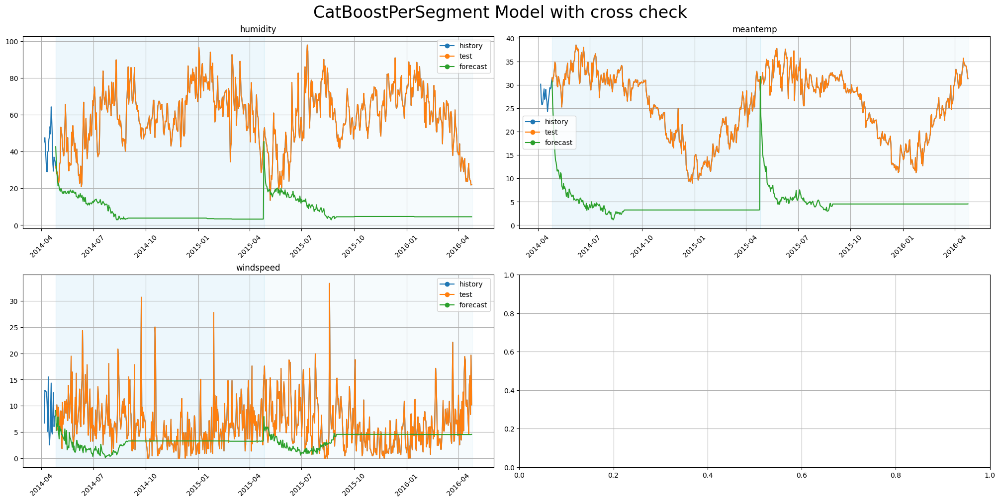

In [ ]:
plot_backtest(forecast_df, ts=train_ts,history_len=20)
plt.suptitle('CatBoostPerSegment Model with cross check', size=24)
plt.savefig('cat_boost_model_with_check2.png')

In [ ]:
import math
def etna_cv_optimize(ts, model, HORIZON, transforms, n_folds, mode, metrics):
  bestmetric = math.inf
  besttrans = transforms[0]

  for transform in transforms:
    pipeline = Pipeline(model=model,
                      transforms=transform,
                      horizon=HORIZON)
    train_ts, test_ts = ts.train_test_split(test_size=HORIZON)
    metrics_df, forecast_df, fold_info_df = pipeline.backtest(
      mode= mode,
      ts=train_ts,
      n_folds = n_folds,
      metrics=metrics
    )

    print(transform)
    print(metrics[0].name,": ", metrics_df[metrics[0].name].mean())

    if(bestmetric> metrics_df[metrics[0].name].mean()):
      bestmetric = metrics_df[metrics[0].name].mean()
      besttrans = transform

  print("best ", metrics[0].name, ":", bestmetric)
  print("best transform: ", besttrans)

In [ ]:
etna_cv_optimize(ts, model, HORIZON, [transforms, transforms2], n_folds=2, mode='expand', metrics = [SMAPE()])

[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:   15.4s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   33.0s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   33.0s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.6s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    1.3s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    1.3s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.1s


[LagTransform(in_column = 'target', lags = [128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 236, 237, 238, 239, 240, 241, 242, 243, 244, 245, 246, 247, 248, 249, 250, 251, 252, 253, 254, 255, 256, 257, 258, 259, 260, 261, 262, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286, 287, 288, 289, 290, 291, 292, 293, 294, 295, 296, 297, 298, 299, 300, 301, 302, 303, 304, 305, 306, 307, 308, 309, 310, 311, 312, 313, 314, 315, 316, 317, 318, 3

[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    9.3s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   16.4s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:   16.4s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.4s


[LagTransform(in_column = 'target', lags = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127], out_column = 'lag', ), MeanTransform(in_column = 'target', window = 365, seasonality = 1, alpha = 1, min_periods = 1, fillna = 0, out_column = 'mean_08', )]
SMAPE :  123.88169514442399
best  SMAPE : 49.4926072531361
best transform:  [LagTransform(in_column = 'target', lags = [128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 1

[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.7s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.7s
[Parallel(n_jobs=1)]: Done   1 tasks      | elapsed:    0.0s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.1s
[Parallel(n_jobs=1)]: Done   2 tasks      | elapsed:    0.1s


# **5 Построение модели ARIMA**

In [ ]:
import torch
import warnings
import pandas as pd

warnings.filterwarnings('ignore')

from etna.datasets.tsdataset import TSDataset
from etna.metrics import SMAPE
from etna.analysis import plot_forecast, plot_backtest
from etna.pipeline import Pipeline
import copy

from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.statespace.sarimax import SARIMAX

from etna.transforms import MeanTransform, LagTransform
from etna.analysis import plot_feature_relevance, ModelRelevanceTable
from etna.models import CatBoostPerSegmentModel, CatBoostMultiSegmentModel
import matplotlib.pyplot as plt

In [ ]:
HORIZON = 60
train_ts, test_ts = ts.train_test_split(test_size=HORIZON)

In [ ]:
data = pd.read_csv('DelhiClimate.csv', index_col=['date'],parse_dates=['date'], dayfirst=True)
data = data.drop(columns = ['meanpressure', 'wind_speed', 'humidity', 'Unnamed: 0'])

In [ ]:
climate_data = pd.read_csv('DelhiClimate.csv', index_col=['date'],parse_dates=['date'], dayfirst=True)

In [ ]:
new_df = []
new_df.append(climate_data.humidity)
new_df.append(climate_data.meantemp)
new_df.append(climate_data.wind_speed)

In [ ]:
for segment in new_df:
  dk_fuller = adfuller(segment)
  print ('p-value: ', dk_fuller[1])
  if dk_fuller[0]> dk_fuller[4]['5%']:
      print ('ряд не стационарен')
  else:
      print ('ряд стационарен')

p-value:  0.001123590645613618
ряд стационарен
p-value:  0.11577219866043487
ряд не стационарен
p-value:  0.0011671800082410488
ряд стационарен


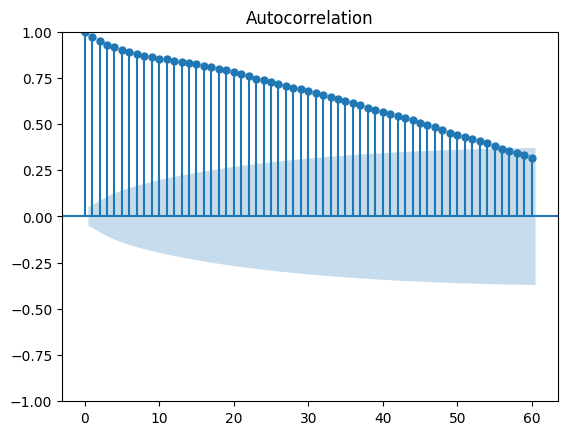

In [ ]:
plot_acf(data, lags=60);

In [ ]:
data['diff_s'] = data - data.shift(1)

p-значение Дики-Фуллера: 1.7284492027788638e-29


<Axes: xlabel='date'>

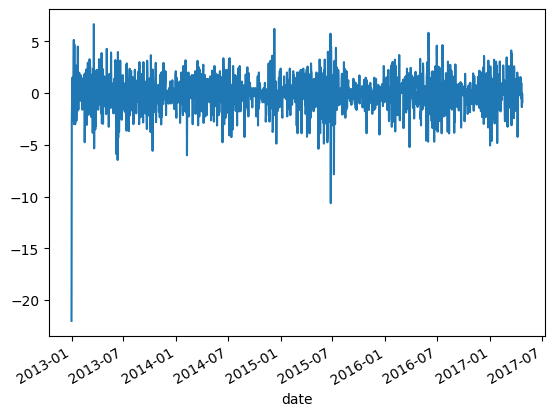

In [ ]:
print(f'p-значение Дики-Фуллера: {adfuller(data.diff_s[1:])[1]}')
data.diff_s[1:].plot()

In [ ]:
data['diff_s_diff'] = data.diff_s - data.diff_s.shift(12)

p-значение Дики-Фуллера: 1.898829625866564e-29


<Axes: xlabel='date'>

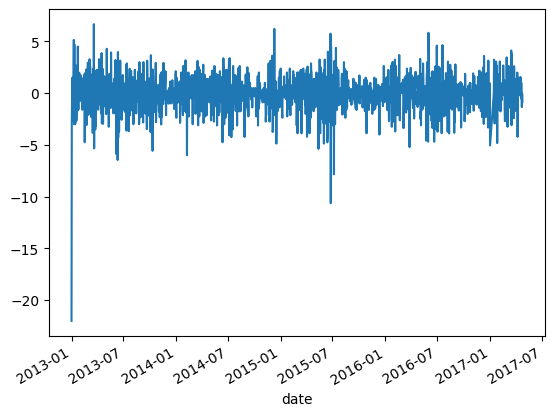

In [ ]:
print(f'p-значение Дики-Фуллера: {adfuller(data.diff_s[13:])[1]}')
data.diff_s[13:].plot()

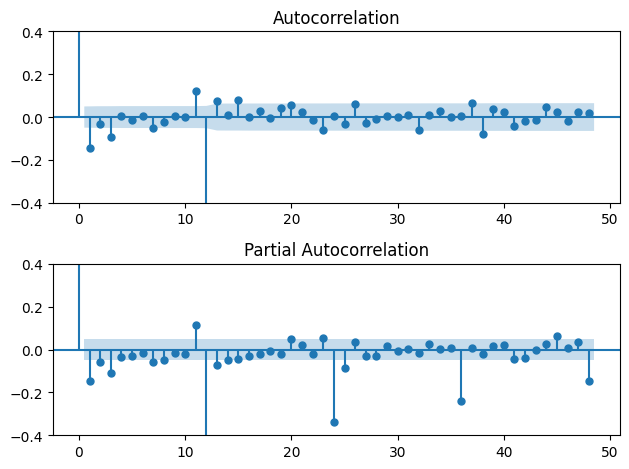

In [ ]:
ax = plt.subplot(211)
plot_acf(data.diff_s_diff[13:].values.squeeze(), lags=48, ax=ax)
plt.ylim([-0.4, 0.4])

ax = plt.subplot(212)
plot_pacf(data.diff_s_diff[13:].values.squeeze(), lags=48, ax=ax)
plt.ylim([-0.4, 0.4])

plt.tight_layout()

In [ ]:
D = 1
d = 1
Q = range(1)
q = range(3)
P = range(1)
p = range(7)

In [ ]:
from itertools import product
import statsmodels.api as sm

In [ ]:
parameters = list(product(p, q, P, Q))
print(len(parameters))
print(parameters[20])

21
(6, 2, 0, 0)


In [ ]:
results = []
best_aic = float('inf')

for param in parameters:
    model = sm.tsa.statespace.SARIMAX(data.meantemp,
                                      order=(param[0], d, param[1]), # несезонная компонента
                                      seasonal_order=(param[2], D, param[3], 12)).fit(disp=-1) # сезонная компонента

    aic = model.aic
    if aic < best_aic:
      best_model = model
      best_aic = aic
      best_param = param
    results.append([param, model.aic])

In [ ]:
result_table = pd.DataFrame(results)
result_table.columns = ['parameters', 'aic']
print(result_table.sort_values(by='aic', ascending=True))

      parameters          aic
20  (6, 2, 0, 0)  7058.826230
17  (5, 2, 0, 0)  7070.145547
14  (4, 2, 0, 0)  7079.200367
11  (3, 2, 0, 0)  7084.629261
8   (2, 2, 0, 0)  7095.943612
7   (2, 1, 0, 0)  7139.965660
5   (1, 2, 0, 0)  7140.235210
19  (6, 1, 0, 0)  7140.238855
16  (5, 1, 0, 0)  7140.750783
13  (4, 1, 0, 0)  7140.895330
10  (3, 1, 0, 0)  7140.922939
4   (1, 1, 0, 0)  7142.504029
9   (3, 0, 0, 0)  7241.550569
12  (4, 0, 0, 0)  7241.801004
15  (5, 0, 0, 0)  7242.289955
18  (6, 0, 0, 0)  7243.968702
2   (0, 2, 0, 0)  7251.641625
1   (0, 1, 0, 0)  7257.291395
6   (2, 0, 0, 0)  7259.168137
3   (1, 0, 0, 0)  7262.254125
0   (0, 0, 0, 0)  7294.357231


In [ ]:
print(best_model.summary())

                                      SARIMAX Results                                      
Dep. Variable:                            meantemp   No. Observations:                 1576
Model:             SARIMAX(6, 1, 2)x(0, 1, [], 12)   Log Likelihood               -3520.413
Date:                             Sun, 12 May 2024   AIC                           7058.826
Time:                                     16:51:33   BIC                           7107.015
Sample:                                          0   HQIC                          7076.742
                                            - 1576                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.1816      0.019     -9.393      0.000      -0.220      -0.144
ar.L2          0.7920      

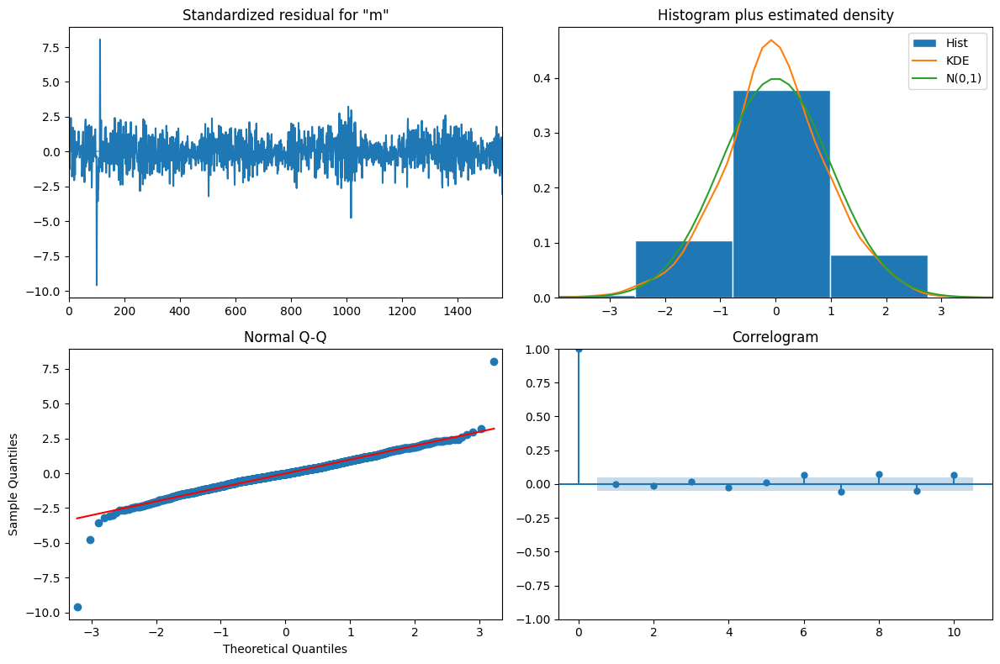

In [ ]:
best_model.plot_diagnostics(figsize=(12, 8))
plt.tight_layout()

In [ ]:
train_ts, test_ts = ts.train_test_split(test_size=HORIZON)

In [ ]:
from etna.models import SARIMAXModel
model_sarimax = SARIMAXModel(order=(3, 1, 1), seasonal_order=(0, 1, 1, 30))
model_sarimax.fit(train_ts)

SARIMAXModel(order = (3, 1, 1), seasonal_order = (0, 1, 1, 30), trend = None, measurement_error = False, time_varying_regression = False, mle_regression = True, simple_differencing = False, enforce_stationarity = True, enforce_invertibility = True, hamilton_representation = False, concentrate_scale = False, trend_offset = 1, use_exact_diffuse = False, dates = None, freq = None, missing = 'none', validate_specification = True, fit_params = {}, )

In [ ]:
future_ts = train_ts.make_future(HORIZON, tail_steps=model_sarimax.context_size)

In [ ]:
forecast_ts = model_sarimax.forecast(future_ts, HORIZON)
forecast_ts

segment      humidity                             meantemp               \
feature        target target_0.025 target_0.975     target target_0.025   
timestamp                                                                 
2017-02-24  48.198857    32.794336    63.603378  19.165944    15.985165   
2017-02-25  54.960134    35.497171    74.423097  19.010629    14.973000   
2017-02-26  59.328553    37.951608    80.705498  19.102342    14.534085   
2017-02-27  61.336971    39.054078    83.619864  19.281135    14.402345   
2017-02-28  62.944716    40.080252    85.809181  19.285328    14.170092   
2017-03-01  62.282497    38.930572    85.634422  19.260202    13.938582   
2017-03-02  61.907389    38.080108    85.734669  19.314745    13.796188   
2017-03-03  61.305869    36.995964    85.615775  19.380531    13.669492   
2017-03-04  60.436422    35.638780    85.234065  19.211458    13.311733   
2017-03-05  60.225917    34.942044    85.509790  19.549144    13.465172   
2017-03-06  60.635506    34.871626    86.399386  19.646180    13.382797   
2017-03-07  59.945522    33.709923    86.181121  19.727882    13.289946   
2017-03-08  59.866537    33.167874    86.565200  19.679876    13.072019   
2017-03-09  58.016739    30.863361    85.170116  19.661485    12.888028   
2017-03-10  57.301115    29.700949    84.901280  19.522464    12.587410   
2017-03-11  56.942340    28.902983    84.981697  19.634904    12.541998   
2017-03-12  58.437443    29.965230    86.909657  19.522752    12.275423   
2017-03-13  58.627666    29.729075    87.526257  19.550007    12.151480   
2017-03-14  58.623989    29.305212    87.942767  19.703656    12.156957   
2017-03-15  58.527649    28.794615    88.260683  19.975361    12.283344   
2017-03-16  58.164848    28.023248    88.306448  19.840282    12.005641   
2017-03-17  57.028151    26.483447    87.572854  19.413183    11.438469   
2017-03-18  55.170373    24.227817    86.112929  19.674242    11.561872   
2017-03-19  55.628687    24.293330    86.964044  19.765118    11.517389   
2017-03-20  56.460358    24.737063    88.183653  19.804356    11.423455   
2017-03-21  57.081633    24.975088    89.188178  19.873335    11.361345   
2017-03-22  58.847817    26.362542    91.333092  20.038362    11.397271   
2017-03-23  58.513784    25.654145    91.373423  20.247809    11.479518   
2017-03-24  59.483705    26.253919    92.713491  19.631943    10.738271   
2017-03-25  57.452636    23.856780    91.048491  19.924757    10.907447   
2017-03-26  57.350118    23.346817    91.353418  20.079712    10.929644   
2017-03-27  59.303000    24.907510    93.698490  19.569777    10.291209   
2017-03-28  60.353216    25.578828    95.127603  19.412868    10.008721   
2017-03-29  60.947389    25.805445    96.089333  19.486400     9.959717   
2017-03-30  62.174340    26.671899    97.676782  19.459594     9.812495   
2017-03-31  61.559250    25.700977    97.417523  19.435802     9.669993   
2017-04-01  61.318421    25.107843    97.528999  19.498649     9.615577   
2017-04-02  60.818116    24.258402    97.377829  19.571132     9.572144   
2017-04-03  59.999484    23.093744    96.905224  19.405556     9.291950   
2017-04-04  59.805992    22.557337    97.054646  19.744520     9.517564   
2017-04-05  60.216969    22.628487    97.805451  19.841759     9.502688   
2017-04-06  59.523838    21.598545    97.449130  19.923317     9.473328   
2017-04-07  59.441857    21.182667    97.701048  19.875142     9.315392   
2017-04-08  57.590342    19.000072    96.180613  19.856645     9.188248   
2017-04-09  56.874037    17.955497    95.792577  19.717578     8.941620   
2017-04-10  56.515126    17.271162    95.759090  19.830006     8.947547   
2017-04-11  58.010287    18.443982    97.576592  19.717854     8.730077   
2017-04-12  58.200594    18.314553    98.086635  19.745113     8.653017   
2017-04-13  58.196972    17.993738    98.400206  19.898765     8.703323   
2017-04-14  58.100657    17.582712    98.618602  20.170471     8.872628   
2017-04-15  57.737863    

In [ ]:
smape = SMAPE()
arimasmape = smape(y_true=test_ts, y_pred=forecast_ts)
arimasmape

{'humidity': 39.30621706815119,
 'meantemp': 27.660594551659685,
 'windspeed': 35.53304348361902}

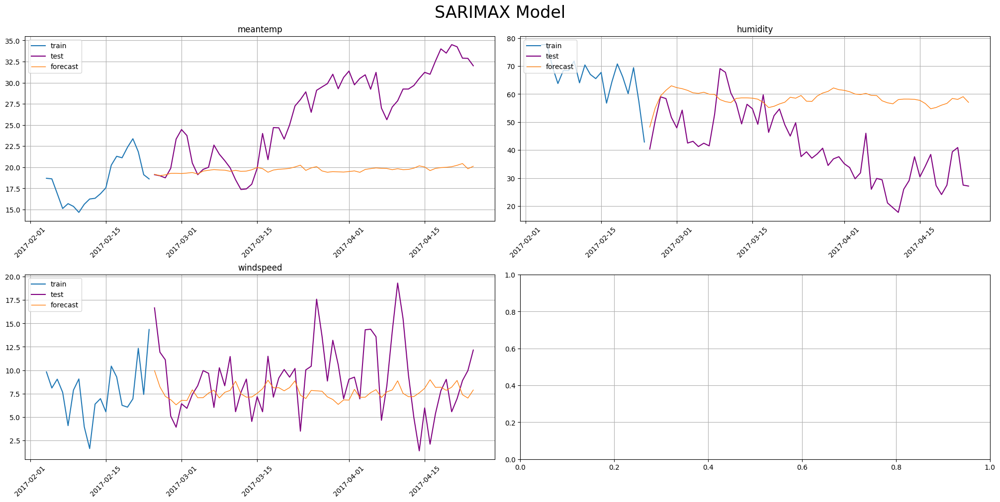

In [ ]:
plot_forecast(forecast_ts, test_ts, train_ts, n_train_samples=20)
plt.suptitle('SARIMAX Model', size=24)
plt.savefig('sarimax_model.png')

# **6 Построение ETS моделей**

В этом разделе построим модель экспоненциального среднего, модель Хольта, модель Хольта-Винтерса.

## Модель Хольта-Винтерса

In [ ]:
from etna.models import HoltWintersModel
from etna.models import SimpleExpSmoothingModel
from etna.models import HoltModel

In [ ]:
HORIZON = 31
train_ts, test_ts = ts.train_test_split(test_size=HORIZON)


In [ ]:
# создаем модель
model_holtwinters = HoltWintersModel(
    seasonal='additive',
    trend='additive',
    seasonal_periods=12,
    smoothing_level=0.05,
    smoothing_trend=0.01,
    smoothing_seasonal=0.35
)

In [ ]:
model_holtwinters.fit(train_ts)
future_ts = train_ts.make_future(HORIZON)
forecast_ts = model_holtwinters.forecast(future_ts)
forecast_ts

segment,humidity,meantemp,windspeed
feature,target,target,target
timestamp,,,
2017-03-25,49.165013,22.234120,8.191173
2017-03-26,53.119541,22.350036,6.414012
2017-03-27,50.027719,22.057986,7.600681
2017-03-28,47.302343,23.430983,7.218285
2017-03-29,52.681181,22.017505,10.746687
2017-03-30,47.367367,22.838476,8.421397
2017-03-31,46.648891,23.394399,8.568481
2017-04-01,50.325409,22.669263,10.242727


In [ ]:
smape = SMAPE()
holtwinterssmape = smape(y_true=test_ts, y_pred=forecast_ts)
holtwinterssmape

{'humidity': 44.119915481675385,
 'meantemp': 28.90860921439123,
 'windspeed': 41.193640915446665}

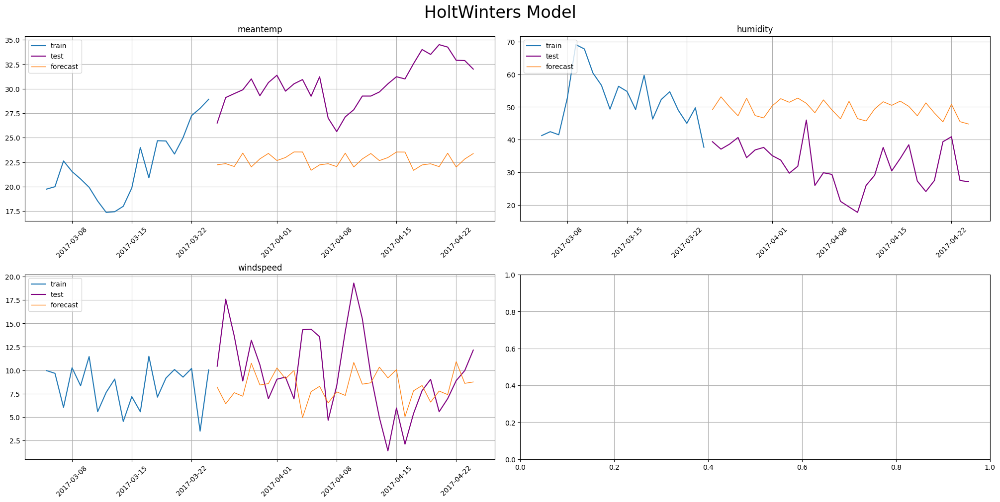

In [ ]:
plot_forecast(forecast_ts, test_ts, train_ts, n_train_samples=20)
plt.suptitle('HoltWinters Model', size=24)
plt.savefig('holt_winters_model.png')

## Модель экспоненциального сглаживания

In [ ]:
# создаем модель
model_smooth = SimpleExpSmoothingModel(
    seasonal='additive',
    trend='additive',
    initialization_method = 'heuristic',
    smoothing_level=0.5,
)
model_smooth.fit(train_ts)
future_ts = train_ts.make_future(HORIZON)
forecast_ts = model_smooth.forecast(future_ts)
forecast_ts

segment,humidity,meantemp,windspeed
feature,target,target,target
timestamp,,,
2017-03-25,44.960256,27.783250,8.158134
2017-03-26,44.807498,27.733531,7.702689
2017-03-27,43.573999,27.887931,8.464929
2017-03-28,43.334828,27.940028,8.503278
2017-03-29,42.820099,28.076520,8.371908
2017-03-30,42.522008,28.023146,8.327696
2017-03-31,43.299496,27.971454,8.361829
2017-04-01,44.770599,27.870387,8.188903


In [ ]:
smape = SMAPE()
smoothsmape = smape(y_true=test_ts, y_pred=forecast_ts)
smoothsmape

{'humidity': 32.30031188042304,
 'meantemp': 9.252779683238662,
 'windspeed': 39.77544653516058}

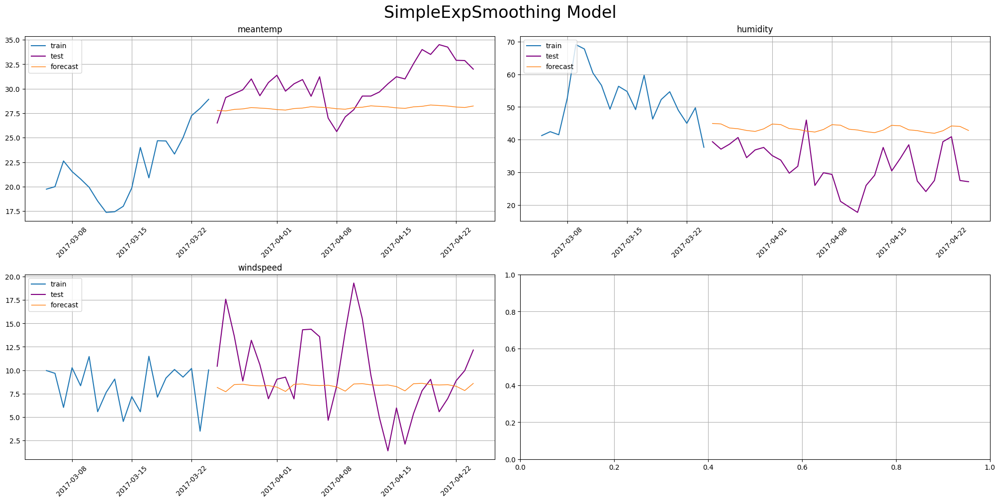

In [ ]:
plot_forecast(forecast_ts, test_ts, train_ts, n_train_samples=20)
plt.suptitle('SimpleExpSmoothing Model', size=24)
plt.savefig('SES_model.png')

## Модель Хольта

In [ ]:
# создаем модель
model_holt = HoltModel(
    seasonal='additive',
    exponential = False,
    seasonal_periods=12,
    smoothing_level=0.5,
    smoothing_trend=0.01,
)
model_holt.fit(train_ts)
future_ts = train_ts.make_future(HORIZON)
forecast_ts = model_holt.forecast(future_ts)
forecast_ts

segment,humidity,meantemp,windspeed
feature,target,target,target
timestamp,,,
2017-03-25,42.511112,28.017981,8.593103
2017-03-26,42.326272,28.064780,8.494405
2017-03-27,41.248148,28.116569,9.299793
2017-03-28,41.305979,28.183818,9.149517
2017-03-29,41.434385,28.229361,9.070069
2017-03-30,41.047163,28.428850,8.403117
2017-03-31,40.577980,28.537336,8.555824
2017-04-01,40.731808,28.717390,8.256105


In [ ]:
smape = SMAPE()
holtsmape = smape(y_true=test_ts, y_pred=forecast_ts)
holtsmape

{'humidity': 24.224460639424723,
 'meantemp': 6.831547454258842,
 'windspeed': 38.696051535889595}

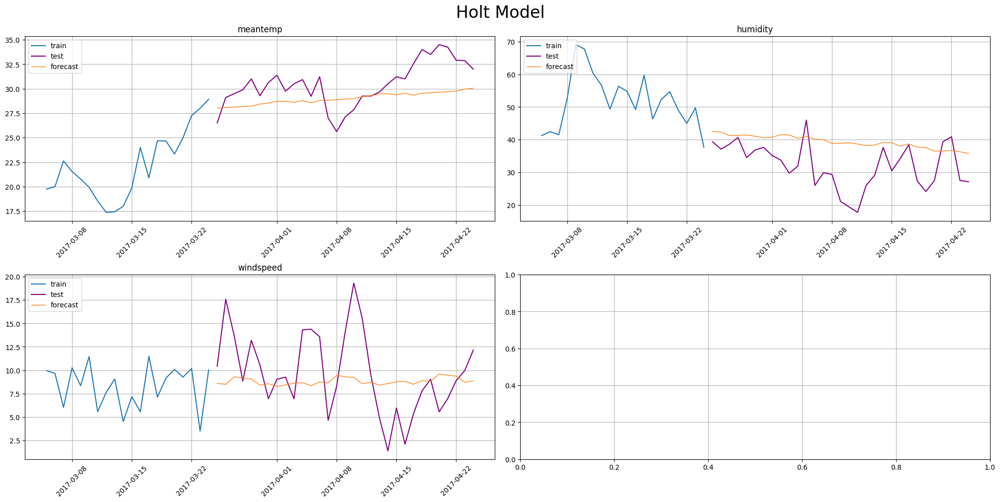

In [ ]:
plot_forecast(forecast_ts, test_ts, train_ts, n_train_samples=20)
plt.suptitle('Holt Model', size=24)
plt.savefig('holt_model.png')

# **7 Выводы**

In [ ]:
import matplotlib.image as mpimg

plot_imgs_models = ['naive_model.jpeg', 'mv_avrg_model.png', 'season_mv_avrg_model.png',
                    'cat_boost_model.png', 'cat_boost_model_with_check.png',
                    'sarimax_model.png', 'SES_model.png', 'holt_model.png',
                    'holt_winters_model.png']

fig, axs = plt.subplots(len(plot_imgs_models), figsize=(50, len(plot_imgs_models)*30))

for i, model in enumerate(plot_imgs_models):
    img = mpimg.imread(model)
    axs[i].imshow(img)
    axs[i].axis('off')

plt.tight_layout()
plt.show()

In [ ]:
models = [model_naive, model_moving, model_seasMovingAvrg, model_catboost, model_sarimax,
          model_smooth, model_holt, model_holtwinters]
smape_values = [naivesmape,movingsmape, best_metrics_seasMovingAvrg,catboostsmape, arimasmape,smoothsmape, holtsmape, holtwinterssmape]
df = pd.DataFrame()

df['Model'] = [model.__class__.__name__ for model in models]
df.set_index('Model', inplace=True)

for i in range(1, 4):
  if i == 1:
    df[f'humidity'] = [val[f'humidity'] for val in smape_values]
  if i == 2:
    df[f'meantemp'] = [val[f'meantemp'] for val in smape_values]
  if i == 3:
    df[f'windspeed'] = [val[f'windspeed'] for val in smape_values]

df['mean_SMAPE'] = df.mean(axis=1)

df['std_SMAPE'] = df.std(axis=1)

display(df)

,humidity,meantemp,windspeed,mean_SMAPE,std_SMAPE
Model,,,,,
NaiveModel,17.751684,13.102553,67.968851,32.941029,24.841025
MovingAverageModel,31.299149,31.322904,40.481798,34.367950,4.323154
SeasonalMovingAverageModel,30.895596,29.673528,39.644219,33.404448,4.440302
CatBoostMultiSegmentModel,49.669576,25.110528,66.626930,47.135678,17.043442
SARIMAXModel,39.306217,27.660595,35.533043,34.166618,4.851492
SimpleExpSmoothingModel,32.300312,9.252780,39.775447,27.109513,12.990165
HoltModel,24.224461,6.831547,38.696052,23.250687,13.026840
HoltWintersModel,44.119915,28.908609,41.193641,38.074055,6.590135
